In [1]:
import sys
from pathlib import Path

# Add the src directory to Python path
src_path = str(Path("./").resolve().parent.parent.parent)
if src_path not in sys.path:
    sys.path.append(src_path)

sys.path

['/root/.local/share/uv/python/cpython-3.11.11-linux-x86_64-gnu/lib/python311.zip',
 '/root/.local/share/uv/python/cpython-3.11.11-linux-x86_64-gnu/lib/python3.11',
 '/root/.local/share/uv/python/cpython-3.11.11-linux-x86_64-gnu/lib/python3.11/lib-dynload',
 '',
 '/runpod-volume/anton/venv311/lib/python3.11/site-packages',
 '/runpod-volume/anton/correctness-model-internals']

In [2]:
from collections import defaultdict

import pandas as pd

from src.classifying import (
    ActivationsHandler,
    combine_activations_handlers,
    get_correctness_direction_classifier,
    get_logistic_regression_classifier,
    get_between_class_variance_and_within_class_variance,
)
from src.visualisations.utils import plot_interactive_lineplot
from src.utils.data import load_activations, load_labels, get_experiment_activations_configs_df_subset


In [3]:
BASE_PATH = "../../../data_for_classification/"
PCA_COMPONENTS = None

PCA_COMONENTS_LABEL = f"_pca_{PCA_COMPONENTS}" if PCA_COMPONENTS else ""

In [4]:
# Set None to get all
MODEL_ID = "mistral_7b_instruct"
# DATASET_ID = "gsm8k"
# PROMPT_ID = "cot_3_shot"
# SUBSET_ID = "main"
# INPUT_TYPE = "prompt_only"
DATASET_ID = None
PROMPT_ID = None
SUBSET_ID = None
INPUT_TYPE = None

activation_exp_configs_df = get_experiment_activations_configs_df_subset(
    base_path=BASE_PATH,
    model_id=MODEL_ID,
    dataset_id=DATASET_ID,
    prompt_id=PROMPT_ID,
    subset_id=SUBSET_ID,
    input_type=INPUT_TYPE,
)
activation_exp_configs_df

parts=('activations', 'raw', 'mistral_7b_instruct', 'trivia_qa_2_60k', 'base', 'main', 'prompt_only', 'layer_8')
parts=('activations', 'raw', 'mistral_7b_instruct', 'trivia_qa_2_60k', 'base', 'main', 'prompt_only', 'layer_6')
parts=('activations', 'raw', 'mistral_7b_instruct', 'trivia_qa_2_60k', 'base', 'main', 'prompt_only', 'layer_4')
parts=('activations', 'raw', 'mistral_7b_instruct', 'trivia_qa_2_60k', 'base', 'main', 'prompt_only', 'layer_30')
parts=('activations', 'raw', 'mistral_7b_instruct', 'trivia_qa_2_60k', 'base', 'main', 'prompt_only', 'layer_28')
parts=('activations', 'raw', 'mistral_7b_instruct', 'trivia_qa_2_60k', 'base', 'main', 'prompt_only', 'layer_26')
parts=('activations', 'raw', 'mistral_7b_instruct', 'trivia_qa_2_60k', 'base', 'main', 'prompt_only', 'layer_24')
parts=('activations', 'raw', 'mistral_7b_instruct', 'trivia_qa_2_60k', 'base', 'main', 'prompt_only', 'layer_22')
parts=('activations', 'raw', 'mistral_7b_instruct', 'trivia_qa_2_60k', 'base', 'main', 'pro

,model_id,dataset_id,prompt_id,subset_id,input_type,layer,path
0,mistral_7b_instruct,trivia_qa_2_60k,base,main,prompt_only,8,../../../data_for_classification/activations/r...
1,mistral_7b_instruct,trivia_qa_2_60k,base,main,prompt_only,6,../../../data_for_classification/activations/r...
2,mistral_7b_instruct,trivia_qa_2_60k,base,main,prompt_only,4,../../../data_for_classification/activations/r...
3,mistral_7b_instruct,trivia_qa_2_60k,base,main,prompt_only,30,../../../data_for_classification/activations/r...
4,mistral_7b_instruct,trivia_qa_2_60k,base,main,prompt_only,28,../../../data_for_classification/activations/r...
...,...,...,...,...,...,...,...
219,mistral_7b_instruct,gsm8k,base_3_shot,main,prompt_answer,16,../../../data_for_classification/activations/r...
220,mistral_7b_instruct,gsm8k,base_3_shot,main,prompt_answer,14,../../../data_for_classification/activations/r...
221,mistral_7b_instruct,gsm8k,base_3_shot,main,prompt_answer,12,../../../data_for_classification/activations/r...
222,mistral_7b_instruct,gsm8k,base_3_shot,main,prompt_answer,10,../../../data_for_classification/activations/r...


In [5]:
activation_exp_configs_df["dataset_id"].unique()

array(['trivia_qa_2_60k', 'cities_10k', 'birth_years_4k', 'medals_9k',
       'math_operations_6k', 'gsm8k'], dtype=object)

In [6]:
activation_exp_configs_df = activation_exp_configs_df[activation_exp_configs_df["dataset_id"].isin(
    ['trivia_qa_2_60k', 'cities_10k', 'birth_years_4k', 'medals_9k', 'math_operations_6k', 'gsm8k']
    # ["cities_10k", "birth_years_4k", "trivia_qa_2_60k"]
    # ["cities_10k", "birth_years_4k"]
)]
activation_exp_configs_df

,model_id,dataset_id,prompt_id,subset_id,input_type,layer,path
0,mistral_7b_instruct,trivia_qa_2_60k,base,main,prompt_only,8,../../../data_for_classification/activations/r...
1,mistral_7b_instruct,trivia_qa_2_60k,base,main,prompt_only,6,../../../data_for_classification/activations/r...
2,mistral_7b_instruct,trivia_qa_2_60k,base,main,prompt_only,4,../../../data_for_classification/activations/r...
3,mistral_7b_instruct,trivia_qa_2_60k,base,main,prompt_only,30,../../../data_for_classification/activations/r...
4,mistral_7b_instruct,trivia_qa_2_60k,base,main,prompt_only,28,../../../data_for_classification/activations/r...
...,...,...,...,...,...,...,...
219,mistral_7b_instruct,gsm8k,base_3_shot,main,prompt_answer,16,../../../data_for_classification/activations/r...
220,mistral_7b_instruct,gsm8k,base_3_shot,main,prompt_answer,14,../../../data_for_classification/activations/r...
221,mistral_7b_instruct,gsm8k,base_3_shot,main,prompt_answer,12,../../../data_for_classification/activations/r...
222,mistral_7b_instruct,gsm8k,base_3_shot,main,prompt_answer,10,../../../data_for_classification/activations/r...


In [7]:
activation_exp_configs_df = activation_exp_configs_df[activation_exp_configs_df["prompt_id"] != "cot_3_shot"] # remove cot_3_shot from gsm8k
activation_exp_configs_df["prompt_id"].unique()

array(['base', 'base_3_shot'], dtype=object)

In [8]:
# layers_to_keep = [0, 5, 10, 15, 20, 25, 27]
layers_to_keep = []

In [9]:

res_dict = defaultdict(list)

n_folds = 5

# for input_type in ["prompt_only", "prompt_answer"]:
for input_type in ["prompt_only"]:
    activation_exp_configs_df_ = activation_exp_configs_df[activation_exp_configs_df["input_type"] == input_type]
    for (model_id_train, dataset_id_train, prompt_id_train, subset_id_train, input_type_train), _ in activation_exp_configs_df_.groupby(["model_id", "dataset_id", "prompt_id", "subset_id", "input_type"]):
        for (model_id_test, dataset_id_test, prompt_id_test, subset_id_test, input_type_test), config_df in activation_exp_configs_df_.groupby(["model_id", "dataset_id", "prompt_id", "subset_id", "input_type"]):
            print(f"\n{model_id_train=}, {dataset_id_train=}, {prompt_id_train=}, {subset_id_train=}, {input_type_train=}")
            print(f"\n{model_id_test=}, {dataset_id_test=}, {prompt_id_test=}, {subset_id_test=}, {input_type_test=}")
            labels_df_train = load_labels(
                base_path=BASE_PATH,
                model_id=model_id_train,
                dataset_id=dataset_id_train,
                prompt_id=prompt_id_train,
                subset_id=subset_id_train,
            )

            labels_df_test = load_labels(
                base_path=BASE_PATH,
                model_id=model_id_test,
                dataset_id=dataset_id_test,
                prompt_id=prompt_id_test,
                subset_id=subset_id_test,
            )

            check_indices_train, check_indices_test = None, None
            for layer in config_df["layer"].astype(int).sort_values():
                if len(layers_to_keep) and layer not in layers_to_keep:
                    continue
                print(f"{layer=}", end=", ")
                activations_train, indices_train = load_activations(
                    base_path=BASE_PATH,
                    model_id=model_id_train,
                    dataset_id=dataset_id_train,
                    prompt_id=prompt_id_train,
                    subset_id=subset_id_train,
                    input_type=input_type_train,
                    layer=layer,
                )
                activations_test, indices_test = load_activations(
                    base_path=BASE_PATH,
                    model_id=model_id_test,
                    dataset_id=dataset_id_test,
                    prompt_id=prompt_id_test,
                    subset_id=subset_id_test,
                    input_type=input_type_test,
                    layer=layer,
                )
                
                if check_indices_train is None:
                    check_indices_train = indices_train.sample(frac=1, replace=False, random_state=42)
                
                if set(indices_train) != set(check_indices_train):
                    raise RuntimeError(f"indices across layers are not the same")

                labels_df_subset_train = labels_df_train.iloc[check_indices_train]
                activations_train = activations_train[check_indices_train]
                
                activations_handler_train = ActivationsHandler(
                    activations=activations_train,
                    labels=labels_df_subset_train["correct"].astype(bool),
                )

                activations_handler_folds_train = list(
                    activations_handler_train.split_dataset(split_sizes=[1/n_folds] * n_folds)
                )

                if check_indices_test is None:
                    check_indices_test = indices_test.sample(frac=1, replace=False, random_state=42)
                
                if set(indices_test) != set(check_indices_test):
                    raise RuntimeError(f"indices across layers are not the same")


                labels_df_subset_test = labels_df_test.iloc[check_indices_test]
                activations_test = activations_test[check_indices_test]

                activations_handler_test = ActivationsHandler(
                    activations=activations_test,
                    labels=labels_df_subset_test["correct"].astype(bool),
                )

                activations_handler_folds_test = list(
                    activations_handler_test.split_dataset(split_sizes=[1/n_folds] * n_folds)
                )

                fold_stats = {}
                for fold_i in range(n_folds):
                    print(f"{fold_i=}", end=", ")
                    activations_handler_test = activations_handler_folds_test[fold_i]
                # for fold_i, activations_handler_test in enumerate(activations_handler_folds_train):
                    activations_handler_train = combine_activations_handlers(
                        [ah for j, ah in enumerate(activations_handler_folds_train) if j != fold_i]
                    )
                    
                    activations_handler_train, pca_info = activations_handler_train.reduce_dims(pca_components=PCA_COMPONENTS)
                    
                    activations_handler_train = activations_handler_train.sample_equally_across_groups(
                        group_labels=[False, True]
                    )
                    activations_handler_test, _ = activations_handler_test.reduce_dims(pca_components=PCA_COMPONENTS, pca_info=pca_info)
                    activations_handler_test = activations_handler_test.sample_equally_across_groups(
                        group_labels=[False, True]
                    )

                    res_dict["model_id_train"].append(model_id_train)
                    res_dict["dataset_id_train"].append(dataset_id_train)
                    res_dict["prompt_id_train"].append(prompt_id_train)
                    res_dict["subset_id_train"].append(subset_id_train)
                    res_dict["input_type_train"].append(input_type_train)
                    res_dict["model_id_test"].append(model_id_test)
                    res_dict["dataset_id_test"].append(dataset_id_test)
                    res_dict["prompt_id_test"].append(prompt_id_test)
                    res_dict["subset_id_test"].append(subset_id_test)
                    res_dict["input_type_test"].append(input_type_test)
                    res_dict["layer"].append(layer)
                    res_dict["fold"].append(fold_i)

                    for center_from_origin in [False, True]:
                        for classifier_cut_name,classifier_cut in [("optimal_train_set_cut", None), ("zero", 0.0)]:
                            direction_classifier, direction_calculator = get_correctness_direction_classifier(
                                activations_handler_train=activations_handler_train,
                                activations_handler_test=activations_handler_test,
                                center_from_origin=center_from_origin,
                                binary_classifier_kwargs={"classification_cut": classifier_cut},
                            )
                            for key, value in direction_classifier.classification_metrics.items():
                                res_dict[
                                    f"direction__center_from_origin_{center_from_origin}__classifier_cut_{classifier_cut_name}__{key}"
                                ].append(value)
                    
                    # can use any of the direction calculators as they should be the same
                    res_dict["direction__train_set_classifying_direction"].append(direction_calculator.classifying_direction.tolist())

                    # for key, value in get_logistic_regression_classifier(
                    #         activations_handler_train=activations_handler_train,
                    #         activations_handler_test=activations_handler_test,
                    #     )[0].classification_metrics.items():
                    #     res_dict[f"logistic__regression_{key}"].append(value)



res_df = pd.DataFrame(res_dict)
res_df


model_id_train='mistral_7b_instruct', dataset_id_train='birth_years_4k', prompt_id_train='base', subset_id_train='main', input_type_train='prompt_only'

model_id_test='mistral_7b_instruct', dataset_id_test='birth_years_4k', prompt_id_test='base', subset_id_test='main', input_type_test='prompt_only'
layer=0, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=2, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=4, fold_i=0, fold_i=1, fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, layer=6, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=8, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=10, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=12, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=14, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=16, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=18, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=20, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=22, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=24, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=26, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=28, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=30, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, 
model_id_train='mistral_7b_instruct', dataset_id_train='birth_years_4k', prompt_id_train='base', subset_id_train='main', input_type_train='prompt_only'

model_id_test='mistral_7b_instruct', dataset_id_test='citi

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anto

fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anto

layer=2, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=4, fold_i=0, fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=6, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=8, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=10, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=12, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=14, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=16, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=18, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=20, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=22, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=24, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=26, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=28, fold_i=0, fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, fold_i=3, fold_i=4, layer=30, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, 
model_id_train='mistral_7b_instruct', dataset_id_train='birth_years_4k', prompt_id_train='base', subset_id_train='main', input_type_train='prompt_only'

model_id_test='mistral_7b_instruct', dataset_id_test='gsm8k', prompt_id_test='base_3_shot', subset_id_test='main', input_type_test='prompt_only'
layer=0, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anto

fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anto

fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anto

layer=2, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=4, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=6, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=8, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=10, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=12, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=14, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=16, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=18, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=20, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=22, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=24, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=26, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=28, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=30, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))



model_id_train='mistral_7b_instruct', dataset_id_train='birth_years_4k', prompt_id_train='base', subset_id_train='main', input_type_train='prompt_only'

model_id_test='mistral_7b_instruct', dataset_id_test='math_operations_6k', prompt_id_test='base', subset_id_test='main', input_type_test='prompt_only'
layer=0, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anto

fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anto

fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anto

layer=2, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=4, fold_i=0, fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=6, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=8, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=10, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=12, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=14, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=16, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=18, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=20, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=22, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=24, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=26, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=28, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=30, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, 
model_id_train='mistral_7b_instruct', dataset_id_train='birth_years_4k', prompt_id_train='base', subset_id_train='main', input_type_train='prompt_only'

model_id_test='mistral_7b_instruct', dataset_id_test='medals_9k', pr

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anto

fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anto

fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anto

fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anto

fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anto

layer=2, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=4, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anto

layer=6, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=8, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=10, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=12, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=14, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=16, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=18, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=20, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=22, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=24, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=26, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, fold_i=3, fold_i=4, layer=28, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=30, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, 
model_id_train='mistral_7b_instruct', dataset_id_train='birth_years_4k', prompt_id_train='base', subset_id_train='main', input_type_train='prompt_only'

model_id_test='mistral_7b_instruct', dataset_id_test='trivia_qa_2_60k', prompt_id_test='base', subset_id_test='main', input_type_test='prompt_only'
layer=0, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=2, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=4, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=6, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=8, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=10, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=12, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=14, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=16, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=18, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=20, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=22, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=24, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=26, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=28, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=30, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, 
model_id_train='mistral_7b_instruct', dataset_id_train='cities_10k', prompt_id_train='base', subset_id_

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=4, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=6, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=8, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=10, fold_i=0, fold_i=1, fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, fold_i=4, layer=12, fold_i=0, fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=14, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=16, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=18, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=20, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=22, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=24, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=26, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=28, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=30, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, 
model_id_train='mistral_7b_instruct', dataset_id_train='cities_10k', prompt_id_train='base', subset_id_train='main', input_type_train='prompt_only'

model_id_test='mistral_7b_instruct', dataset_id_test='cities_10k', prompt_id_test='base', subset_id_test='main', input_type_test='prompt_only'
layer=0, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=2, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=4, fold_i=0, fold_i=1, fold_i=2, fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=10, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=12, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=14, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=16, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=18, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=20, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=22, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=24, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=26, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=28, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=30, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, 
model_id_train='mistral_7b_instruct', dataset_id_train='cities_10k', prompt_id_train='base', subset_id_train='main', input_type_train='prompt_only'

model_id_test='mistral_7b_instruct', dataset_id_test='gsm8k', prompt_id_test='base_3_shot', subset_id_test='main', input_type_test='prompt_only'
layer=0, fold_i=0, fold_i=1, fold_i=2, fold_i

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=10, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=12, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=14, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=16, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=18, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=20, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=22, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=24, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=26, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=28, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=30, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, 
model_id_train='mistral_7b_instruct', dataset_id_train='cities_10k', prompt_id_train='base', subset_id_train='main', input_type_train='prompt_only'

model_id_test='mistral_7b_instruct', dataset_id_test='math_operations_6k', prompt_id_test='base', subset_id_test='main', input_type_test='prompt_only'
layer=0, fold_i=0, fold_i=1, fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=10, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=12, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=14, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=16, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=18, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=20, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=22, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=24, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=26, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=28, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=30, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, 
model_id_train='mistral_7b_instruct', dataset_id_train='cities_10k', prompt_id_train='base', subset_id_train='main', input_type_train='prompt_only'

model_id_test='mistral_7b_instruct', dataset_id_test='medals_9k', prompt_id_test='base', subset_id_test='main', input_type_test='prompt_only'
layer=0, fold_i=0, fold_i=1, fold_i=2, fold_i=3,

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=10, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=12, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=14, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=16, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=18, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=20, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=22, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=24, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=26, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=28, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=30, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, 
model_id_train='mistral_7b_instruct', dataset_id_train='cities_10k', prompt_id_train='base', subset_id_train='main', input_type_train='prompt_only'

model_id_test='mistral_7b_instruct', dataset_id_test='trivia_qa_2_60k', prompt_id_test='base', subset_id_test='main', input_type_test='prompt_only'
layer=0, fold_i=0, fold_i=1, fold_i=2, fol

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=10, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=12, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=14, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=16, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=18, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=20, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=22, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=24, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=26, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=28, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=30, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, 
model_id_train='mistral_7b_instruct', dataset_id_train='gsm8k', prompt_id_train='base_3_shot', subset_id_train='main', input_type_train='prompt_only'

model_id_test='mistral_7b_instruct', dataset_id_test='birth_years_4k', prompt_id_test='base', subset_id_test='main', input_type_test='prompt_only'
layer=0, fold_i=0, fold_i=1, fold_i=2, fo

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))



model_id_train='mistral_7b_instruct', dataset_id_train='gsm8k', prompt_id_train='base_3_shot', subset_id_train='main', input_type_train='prompt_only'

model_id_test='mistral_7b_instruct', dataset_id_test='cities_10k', prompt_id_test='base', subset_id_test='main', input_type_test='prompt_only'
layer=0, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=2, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=4, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=6, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=8, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=10, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=12, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=14, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=16, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=18, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=20, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=22, fold_i=0, fold_i=1, fold_i=2, fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))



model_id_train='mistral_7b_instruct', dataset_id_train='gsm8k', prompt_id_train='base_3_shot', subset_id_train='main', input_type_train='prompt_only'

model_id_test='mistral_7b_instruct', dataset_id_test='gsm8k', prompt_id_test='base_3_shot', subset_id_test='main', input_type_test='prompt_only'
layer=0, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=2, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=4, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=6, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=8, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=10, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=12, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=14, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=16, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=18, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=20, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=22, fold_i=0, fold_i=1, fold_i=2, fold_i=3

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=2, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=4, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=6, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=8, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=10, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=12, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=14, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=16, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=18, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=20, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=22, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=24, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=26, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=28, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=30, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, 
model_id_train='mistral_7b_instruct', dataset_id_train='math_operations_6k', prompt_id_train='base', subset_id_train='main', input_type_train='prompt_only'

model

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=2, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=4, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=6, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=8, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=10, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=12, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=14, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=16, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=18, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=20, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=22, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=24, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=26, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=28, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=30, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, 
model_id_train='mistral_7b_instruct', dataset_id_train='math_operations_6k', prompt_id_train='base', subset_id_train='main', input_type_train='prompt_only'

model_id_test='mistral_7b_instruct', dataset_id_test='gsm8k', prompt_id_test='base_3_shot', subset_id_test='main', input_type_test='prompt_only'
layer=0, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=2, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=4, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=6, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=8, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=10, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=12, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=14, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=16, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=18, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=20, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=22, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=24, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=26, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=28, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=30, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, 
model_id_train='mistral_7b_instruct', dataset_id_train='math_operations_6k', prompt_id_train='base', subset_id_train='main', input_type_train='prompt_only'

model

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=2, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=4, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=6, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=8, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=10, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=12, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=14, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=16, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=18, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=20, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=22, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=24, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=26, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=28, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=30, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, 
model_id_train='mistral_7b_instruct', dataset_id_train='math_operations_6k', prompt_id_train='base', subset_id_train='main', input_type_train='prompt_only'

model

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anto

fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anto

fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anto

fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anto

fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anto

layer=2, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anto

fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anto

fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anto

fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anto

fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anto

layer=4, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=6, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=8, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=10, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=12, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=14, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=16, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=18, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=20, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=22, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=24, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=26, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=28, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=30, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, 
model_id_train='mistral_7b_instruct', dataset_id_train='math_operations_6k', prompt_id_train='base', subset_id_train='main', input_type_train='prompt_only'

model_id_test='mistral_7b_instruct', dataset_id_test='trivia_qa_2_60k', prompt_id_test='base', subset_id_test='main', input_type_test='prompt_only'
layer=0, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=2, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=4, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=6, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=8, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=10, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=12, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=14, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=16, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=18, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=20, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=22, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=24, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=26, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=28, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=30, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, 
model_id_train='mistral_7b_instruct', dataset_id_train='medals_9k', prompt_id_train='base', subset_id_train='main', input_type_train='prompt_only'

model_id_test=

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=2, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=4, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=6, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=8, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=10, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=12, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=14, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=16, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=18, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=20, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, fold_i=3, fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=22, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=24, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anto

fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=26, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=28, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=30, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, 
model_id_train='mistral_7b_instruct', dataset_id_train='medals_9k', prompt_id_train='base', subset_id_train='main', input_type_train='prompt_only'

model_id_test='mistral_7b_instruct', dataset_id_test='cities_10k', prompt_id_test='base', subset_id_test='main', input_type_test='prompt_only'
layer=0, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=2, fold_i=0, fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, layer=4, fold_i=0, fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anto

fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, layer=6, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anto

fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anto

fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anto

fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=8, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=10, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=12, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=14, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=16, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=18, fold_i=0, fold_i=1, fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=20, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=22, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=24, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=26, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=28, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=30, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, 
model_id_train='mistral_7b_instruct', dataset_id_train='medals_9k', prompt_id_train='base', subset_id_train='main', input_type_train='prompt_only'

model_id_test='mistral_7b_instruct', dataset_id_test='gsm8k', prompt_id_test='base_3_shot', subset_id_test='main', input_type_test='prompt_only'
layer=0, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=2, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=4, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=6, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=8, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=10, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=12, fold_i=0, fold_i=1, fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, fold_i=4, layer=14, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=16, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=18, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=20, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=22, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=24, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=26, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=28, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=30, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, 
model_id_train='mistral_7b_instruct', dataset_id_train='medals_9k', prompt_id_train='base', subset_id_train='main', input_type_train='prompt_only'

model_id_test='mistral_7b_instruct', dataset_id_test='math_operations_6k', prompt_id_test='base', subset_id_test='main', input_type_test='prompt_only'
layer=0, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=2, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=4, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=6, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=8, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=10, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=12, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=14, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=16, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=18, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=20, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=22, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=24, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=26, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=28, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=30, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, 
model_id_train='mistral_7b_instruct', dataset_id_train='medals_9k', prompt_id_train='base', subset_id_train='main', input_type_train='prompt_only'

model_id_test='mistral_7b_instruct', dataset_id_test='medals_9k', prompt_id_test='base', subset_id_test='main', input_type_test='prompt_only'
layer=0, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=2, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=4, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=6, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=8, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=10, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=12, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=14, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=16, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=18, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=20, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=22, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=24, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=26, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=28, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=30, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, 
model_id_train='mistral_7b_instruct', dataset_id_train='medals_9k', prompt_id_train='base', subset_id_train='main', input_type_train='prompt_only'

model_id_test='mistral_7b_instruct', dataset_id_test='trivia_qa_2_60k', prompt_id_test='base', subset_id_test='main', input_type_tes

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=8, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=10, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=12, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=14, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=16, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=18, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=20, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=22, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=24, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=26, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=28, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=30, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, 
model_id_train='mistral_7b_instruct', dataset_id_train='trivia_qa_2_60k', prompt_id_train='base', subset_id_train='main', input_type_train='prompt_only'

model_id_test='mistral_7b_instruct', dataset_id_test='birth_years_4k', prompt_id_test='base', subset_id_test='main', input_typ

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=4, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=6, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=8, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=10, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=12, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=14, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=16, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=18, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=20, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=22, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=24, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=26, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=28, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=30, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, 
model_id_train='mistral_7b_instruct', dataset_id_train='trivia_qa_2_60k', prompt_id_train='base', subset_id_train='main', input_type_train='prompt_only'

model_id_test='mistral_7b_instruct', dataset_id_test='math_operations_6k', prompt_id_test='base', subset_id_test='main', input_type_test='prompt_only'
layer=0, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=2, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=4, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=6, fold_i=0, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=1, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=2, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=3, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fold_i=4, 

/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/runpod-volume/anton/venv311/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


layer=8, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=10, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=12, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=14, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=16, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=18, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=20, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=22, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=24, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=26, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=28, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, layer=30, fold_i=0, fold_i=1, fold_i=2, fold_i=3, fold_i=4, 
model_id_train='mistral_7b_instruct', dataset_id_train='trivia_qa_2_60k', prompt_id_train='base', subset_id_train='main', input_type_train='prompt_only'

model_id_test='mistral_7b_instruct', dataset_id_test='medals_9k', prompt_id_test='base', subset_id_test='main', input_type_tes

,model_id_train,dataset_id_train,prompt_id_train,subset_id_train,input_type_train,model_id_test,dataset_id_test,prompt_id_test,subset_id_test,input_type_test,...,direction__center_from_origin_True__classifier_cut_zero__test_roc_auc,direction__center_from_origin_True__classifier_cut_zero__train_accuracy_score,direction__center_from_origin_True__classifier_cut_zero__test_accuracy_score,direction__center_from_origin_True__classifier_cut_zero__train_f1_score,direction__center_from_origin_True__classifier_cut_zero__test_f1_score,direction__center_from_origin_True__classifier_cut_zero__train_precision_score,direction__center_from_origin_True__classifier_cut_zero__test_precision_score,direction__center_from_origin_True__classifier_cut_zero__train_recall_score,direction__center_from_origin_True__classifier_cut_zero__test_recall_score,direction__train_set_classifying_direction
0,mistral_7b_instruct,birth_years_4k,base,main,prompt_only,mistral_7b_instruct,birth_years_4k,base,main,prompt_only,...,0.555002,0.500000,0.500000,0.666667,0.666667,0.500000,0.500000,1.000000,1.000000,"[3.879029009112855e-06, 7.372067329924903e-07,..."
1,mistral_7b_instruct,birth_years_4k,base,main,prompt_only,mistral_7b_instruct,birth_years_4k,base,main,prompt_only,...,0.564952,0.545749,0.537037,0.489351,0.500000,0.558719,0.543478,0.435305,0.462963,"[4.248346158419736e-06, 1.6535054783162195e-06..."
2,mistral_7b_instruct,birth_years_4k,base,main,prompt_only,mistral_7b_instruct,birth_years_4k,base,main,prompt_only,...,0.561917,0.520427,0.512727,0.152584,0.129870,0.654930,0.606061,0.086351,0.072727,"[4.018360414193012e-06, -2.3022778350423323e-0..."
3,mistral_7b_instruct,birth_years_4k,base,main,prompt_only,mistral_7b_instruct,birth_years_4k,base,main,prompt_only,...,0.521306,0.506115,0.494810,0.668770,0.662037,0.503085,0.497391,0.997178,0.989619,"[3.7070387861604104e-06, 6.208302920640563e-07..."
4,mistral_7b_instruct,birth_years_4k,base,main,prompt_only,mistral_7b_instruct,birth_years_4k,base,main,prompt_only,...,0.529948,0.500000,0.500000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,"[4.2945994209731e-06, 5.28943360222911e-07, -6..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2875,mistral_7b_instruct,trivia_qa_2_60k,base,main,prompt_only,mistral_7b_instruct,trivia_qa_2_60k,base,main,prompt_only,...,0.760889,0.519893,0.519815,0.674850,0.675026,0.510185,0.510134,0.996466,0.997427,"[-0.0035415985621511936, 0.056807778775691986,..."
2876,mistral_7b_instruct,trivia_qa_2_60k,base,main,prompt_only,mistral_7b_instruct,trivia_qa_2_60k,base,main,prompt_only,...,0.764547,0.520218,0.519546,0.674919,0.674888,0.510359,0.509995,0.996099,0.997359,"[-0.012463493272662163, 0.06357502937316895, -..."
2877,mistral_7b_instruct,trivia_qa_2_60k,base,main,prompt_only,mistral_7b_instruct,trivia_qa_2_60k,base,main,prompt_only,...,0.763637,0.519738,0.518056,0.674700,0.673502,0.510108,0.509249,0.996104,0.994158,"[-0.010598118416965008, 0.06106802076101303, -..."
2878,mistral_7b_instruct,trivia_qa_2_60k,base,main,prompt_only,mistral_7b_instruct,trivia_qa_2_60k,base,main,prompt_only,...,0.766280,0.519505,0.518252,0.674615,0.673405,0.509985,0.509359,0.996204,0.993316,"[-0.0121388491243124, 0.0637606680393219, -0.0..."


In [10]:
res_df

,model_id_train,dataset_id_train,prompt_id_train,subset_id_train,input_type_train,model_id_test,dataset_id_test,prompt_id_test,subset_id_test,input_type_test,...,direction__center_from_origin_True__classifier_cut_zero__test_roc_auc,direction__center_from_origin_True__classifier_cut_zero__train_accuracy_score,direction__center_from_origin_True__classifier_cut_zero__test_accuracy_score,direction__center_from_origin_True__classifier_cut_zero__train_f1_score,direction__center_from_origin_True__classifier_cut_zero__test_f1_score,direction__center_from_origin_True__classifier_cut_zero__train_precision_score,direction__center_from_origin_True__classifier_cut_zero__test_precision_score,direction__center_from_origin_True__classifier_cut_zero__train_recall_score,direction__center_from_origin_True__classifier_cut_zero__test_recall_score,direction__train_set_classifying_direction
0,mistral_7b_instruct,birth_years_4k,base,main,prompt_only,mistral_7b_instruct,birth_years_4k,base,main,prompt_only,...,0.555002,0.500000,0.500000,0.666667,0.666667,0.500000,0.500000,1.000000,1.000000,"[3.879029009112855e-06, 7.372067329924903e-07,..."
1,mistral_7b_instruct,birth_years_4k,base,main,prompt_only,mistral_7b_instruct,birth_years_4k,base,main,prompt_only,...,0.564952,0.545749,0.537037,0.489351,0.500000,0.558719,0.543478,0.435305,0.462963,"[4.248346158419736e-06, 1.6535054783162195e-06..."
2,mistral_7b_instruct,birth_years_4k,base,main,prompt_only,mistral_7b_instruct,birth_years_4k,base,main,prompt_only,...,0.561917,0.520427,0.512727,0.152584,0.129870,0.654930,0.606061,0.086351,0.072727,"[4.018360414193012e-06, -2.3022778350423323e-0..."
3,mistral_7b_instruct,birth_years_4k,base,main,prompt_only,mistral_7b_instruct,birth_years_4k,base,main,prompt_only,...,0.521306,0.506115,0.494810,0.668770,0.662037,0.503085,0.497391,0.997178,0.989619,"[3.7070387861604104e-06, 6.208302920640563e-07..."
4,mistral_7b_instruct,birth_years_4k,base,main,prompt_only,mistral_7b_instruct,birth_years_4k,base,main,prompt_only,...,0.529948,0.500000,0.500000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,"[4.2945994209731e-06, 5.28943360222911e-07, -6..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2875,mistral_7b_instruct,trivia_qa_2_60k,base,main,prompt_only,mistral_7b_instruct,trivia_qa_2_60k,base,main,prompt_only,...,0.760889,0.519893,0.519815,0.674850,0.675026,0.510185,0.510134,0.996466,0.997427,"[-0.0035415985621511936, 0.056807778775691986,..."
2876,mistral_7b_instruct,trivia_qa_2_60k,base,main,prompt_only,mistral_7b_instruct,trivia_qa_2_60k,base,main,prompt_only,...,0.764547,0.520218,0.519546,0.674919,0.674888,0.510359,0.509995,0.996099,0.997359,"[-0.012463493272662163, 0.06357502937316895, -..."
2877,mistral_7b_instruct,trivia_qa_2_60k,base,main,prompt_only,mistral_7b_instruct,trivia_qa_2_60k,base,main,prompt_only,...,0.763637,0.519738,0.518056,0.674700,0.673502,0.510108,0.509249,0.996104,0.994158,"[-0.010598118416965008, 0.06106802076101303, -..."
2878,mistral_7b_instruct,trivia_qa_2_60k,base,main,prompt_only,mistral_7b_instruct,trivia_qa_2_60k,base,main,prompt_only,...,0.766280,0.519505,0.518252,0.674615,0.673405,0.509985,0.509359,0.996204,0.993316,"[-0.0121388491243124, 0.0637606680393219, -0.0..."


In [59]:
from scipy.spatial.distance import cosine

def cosine_similarity_distribution(vecs, index=None):
    vecs = list(vecs)
    index = list(index) if index is not None else None
    cosine_similarities = []
    indices = []
    for i in range(len(vecs)):
        reference_vec = vecs[i]
        for j in range(len(vecs)):
            if j <= i:
                continue
            cosine_similarity = 1 - cosine(reference_vec, vecs[j])
            cosine_similarities.append(cosine_similarity)
            if index is not None:
                indices.append((index[i], index[j]))
    
    return pd.Series(cosine_similarities, index=indices or None)

Get info on how much the direction varies WITHIN a dataset, across folds

In [12]:
import json

means, stds = [], []
for conf, res_df_ in res_df.groupby([
    "model_id_train", 
    "dataset_id_train", 
    "prompt_id_train", 
    "subset_id_train", 
    "input_type_train",
    # "model_id_test",
    # "dataset_id_test",
    # "prompt_id_test",
    # "subset_id_test",
    # "input_type_test",
    "layer"
]):
    # cos_distr = cosine_similarity_distribution(res_df_["direction__train_set_classifying_direction"].apply(json.loads)) # if is string
    cos_distr = cosine_similarity_distribution(res_df_["direction__train_set_classifying_direction"])
    means.append(cos_distr.mean())
    stds.append(cos_distr.std())

print(pd.Series(means).describe())
print(pd.Series(stds).describe())

count    96.000000
mean      0.993375
std       0.009951
min       0.949054
25%       0.993892
50%       0.997914
75%       0.999421
max       0.999900
dtype: float64
count    96.000000
mean      0.005968
std       0.009186
min       0.000049
25%       0.000365
50%       0.001486
75%       0.005379
max       0.031612
dtype: float64


In [41]:
import json
import numpy as np

directions_dict = defaultdict(list)
for conf, res_df_ in res_df.groupby([
    "model_id_train", 
    "dataset_id_train", 
    "prompt_id_train", 
    "subset_id_train", 
    "input_type_train",
    "layer"
]):
    # directions = res_df_["direction__train_set_classifying_direction"].apply(json.loads) # if is string
    directions = res_df_["direction__train_set_classifying_direction"]
    directions = directions.apply(np.array)
    average_direction = np.sum(directions) / len(directions)

    directions_dict["model_id_train"].append(conf[0])
    directions_dict["dataset_id_train"].append(conf[1])
    directions_dict["prompt_id_train"].append(conf[2])
    directions_dict["subset_id_train"].append(conf[3])
    directions_dict["input_type_train"].append(conf[4])
    # directions_dict["model_id_test"].append(conf[5])
    # directions_dict["dataset_id_test"].append(conf[6])
    # directions_dict["prompt_id_test"].append(conf[7])
    # directions_dict["subset_id_test"].append(conf[8])
    # directions_dict["input_type_test"].append(conf[9])
    directions_dict["layer"].append(conf[5])
    directions_dict["direction"].append(average_direction)

directions_df = pd.DataFrame(directions_dict)
directions_df

,model_id_train,dataset_id_train,prompt_id_train,subset_id_train,input_type_train,layer,direction
0,mistral_7b_instruct,birth_years_4k,base,main,prompt_only,0,"[4.029474757771822e-06, 6.620516160182887e-07,..."
1,mistral_7b_instruct,birth_years_4k,base,main,prompt_only,2,"[-6.855938909211545e-06, 6.23058331257198e-06,..."
2,mistral_7b_instruct,birth_years_4k,base,main,prompt_only,4,"[6.940573575775488e-06, 0.00021238350891508161..."
3,mistral_7b_instruct,birth_years_4k,base,main,prompt_only,6,"[1.788870717973623e-05, -9.006585751194506e-05..."
4,mistral_7b_instruct,birth_years_4k,base,main,prompt_only,8,"[-0.00020065212302142755, -7.905954553280025e-..."
...,...,...,...,...,...,...,...
91,mistral_7b_instruct,trivia_qa_2_60k,base,main,prompt_only,22,"[0.005188555549830198, 0.015451034530997276, -..."
92,mistral_7b_instruct,trivia_qa_2_60k,base,main,prompt_only,24,"[-0.0004150381311774254, 0.017417508363723754,..."
93,mistral_7b_instruct,trivia_qa_2_60k,base,main,prompt_only,26,"[-0.001814055722206831, 0.029743877798318864, ..."
94,mistral_7b_instruct,trivia_qa_2_60k,base,main,prompt_only,28,"[0.0051390358712524176, 0.04441315680742264, 0..."


In [50]:
dir_res_file = f"./classification_data/res_df_train_test_different_datasets{PCA_COMONENTS_LABEL}_directions.parquet"
dir_res_file

'./classification_data/res_df_train_test_different_datasets_directions.parquet'

In [49]:
directions_df.to_parquet(dir_res_file)

In [45]:
directions_df = pd.read_parquet(dir_res_file)
directions_df

,model_id_train,dataset_id_train,prompt_id_train,subset_id_train,input_type_train,layer,direction
0,mistral_7b_instruct,birth_years_4k,base,main,prompt_only,0,"[4.029474757771822e-06, 6.620516160182887e-07,..."
1,mistral_7b_instruct,birth_years_4k,base,main,prompt_only,2,"[-6.855938909211545e-06, 6.23058331257198e-06,..."
2,mistral_7b_instruct,birth_years_4k,base,main,prompt_only,4,"[6.940573575775488e-06, 0.00021238350891508161..."
3,mistral_7b_instruct,birth_years_4k,base,main,prompt_only,6,"[1.788870717973623e-05, -9.006585751194506e-05..."
4,mistral_7b_instruct,birth_years_4k,base,main,prompt_only,8,"[-0.00020065212302142755, -7.905954553280025e-..."
...,...,...,...,...,...,...,...
91,mistral_7b_instruct,trivia_qa_2_60k,base,main,prompt_only,22,"[0.005188555549830198, 0.015451034530997276, -..."
92,mistral_7b_instruct,trivia_qa_2_60k,base,main,prompt_only,24,"[-0.0004150381311774254, 0.017417508363723754,..."
93,mistral_7b_instruct,trivia_qa_2_60k,base,main,prompt_only,26,"[-0.001814055722206831, 0.029743877798318864, ..."
94,mistral_7b_instruct,trivia_qa_2_60k,base,main,prompt_only,28,"[0.0051390358712524176, 0.04441315680742264, 0..."


In [51]:
import matplotlib.pyplot as plt
import seaborn as sns

def plot_dataset_correlations(similarities, indices):
    # Extract unique dataset names
    datasets = list(set([item for pair in indices for item in pair]))

    # Create a correlation matrix
    n = len(datasets)
    matrix = np.zeros((n, n))
    np.fill_diagonal(matrix, 1)  # Fill diagonal with 1s

    # Fill the matrix with values
    for i, (value, pair) in enumerate(zip(similarities, indices)):
        # dataset1, dataset2 = pair.strip('()').split(', ')
        dataset1, dataset2 = pair
        idx1 = datasets.index(dataset1)
        idx2 = datasets.index(dataset2)
        matrix[idx1, idx2] = value
        matrix[idx2, idx1] = value  # Make it symmetric

    # Create heatmap
    plt.figure(figsize=(5, 5))
    sns.heatmap(matrix, 
                xticklabels=datasets,
                yticklabels=datasets,
                cmap='RdBu_r',  # Red-Blue diverging colormap
                center=0,       # Center the colormap at 0
                annot=True,     # Show values
                fmt='.2f')      # Format values to 2 decimal places

    plt.xticks(rotation=45, ha='right')
    plt.yticks(rotation=0)
    plt.title('Cosine similarity between datasets')
    plt.tight_layout()
    plt.show()

Find the cosine similarity across datasets (where the direction for a dataset is it's average direction across folds) for each layer

layer=(0,)


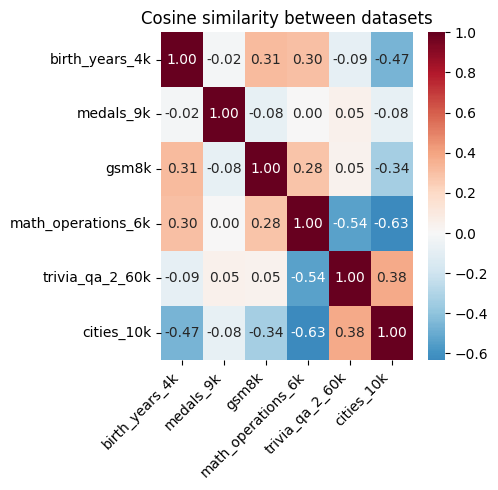

layer=(2,)


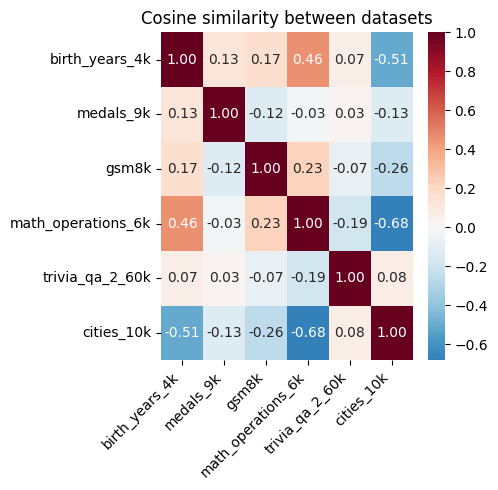

layer=(4,)


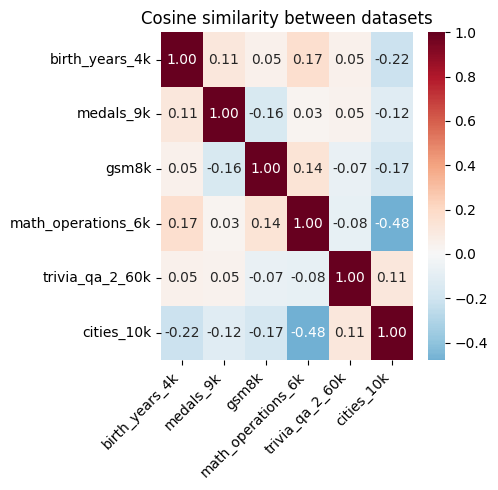

layer=(6,)


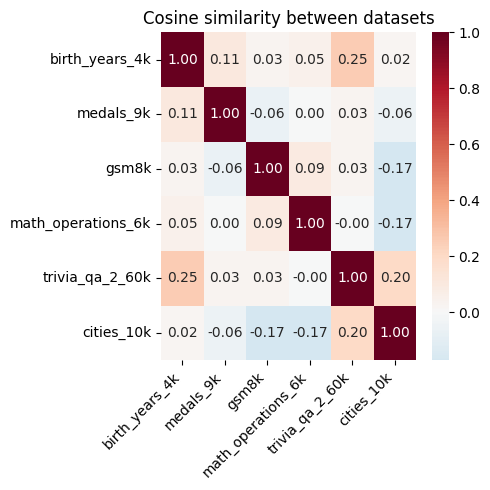

layer=(8,)


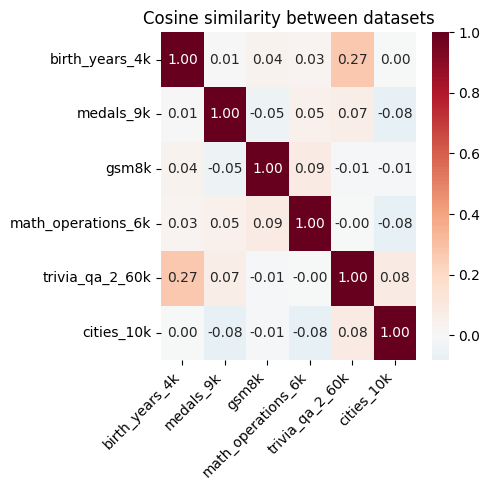

layer=(10,)


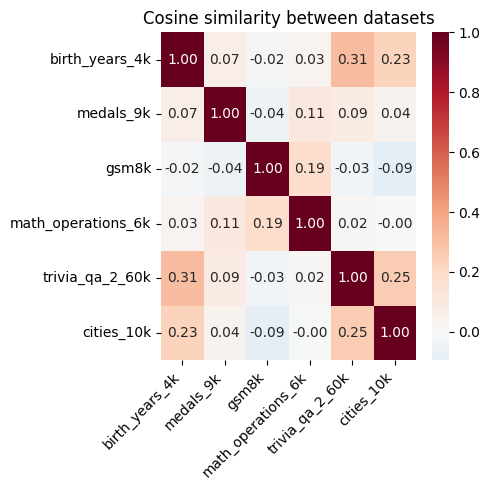

layer=(12,)


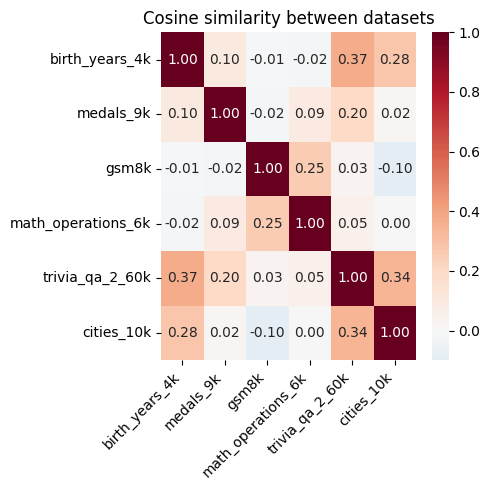

layer=(14,)


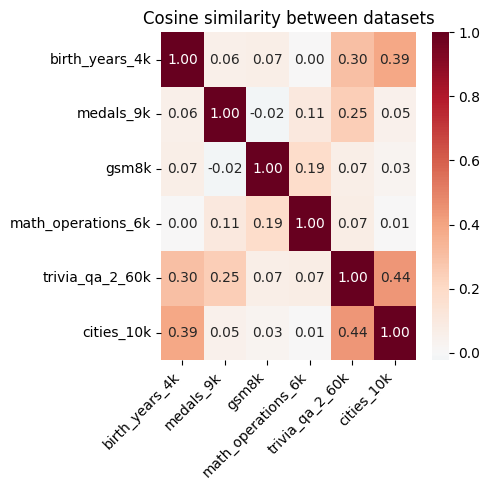

layer=(16,)


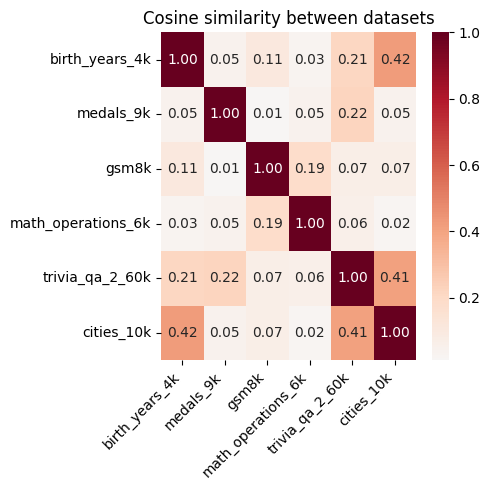

layer=(18,)


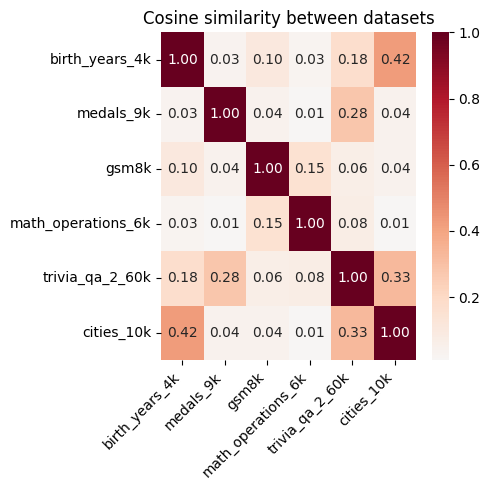

layer=(20,)


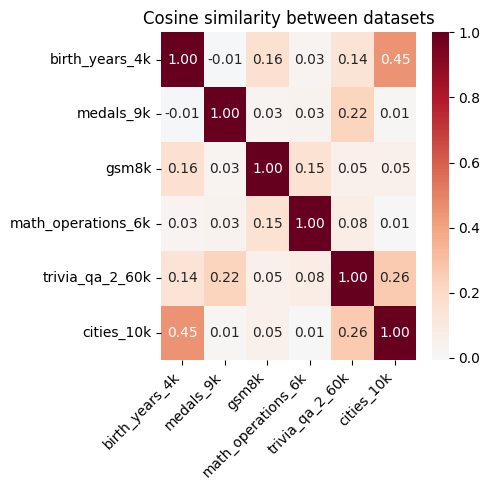

layer=(22,)


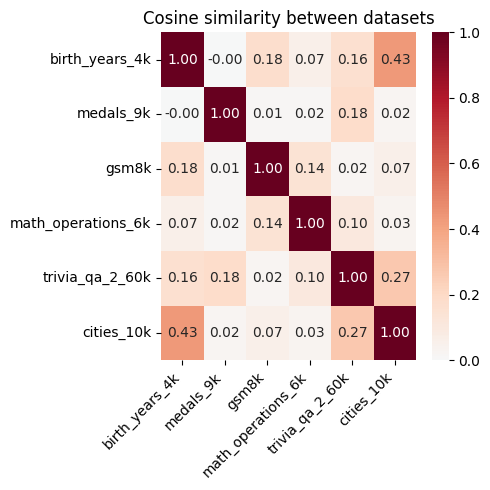

layer=(24,)


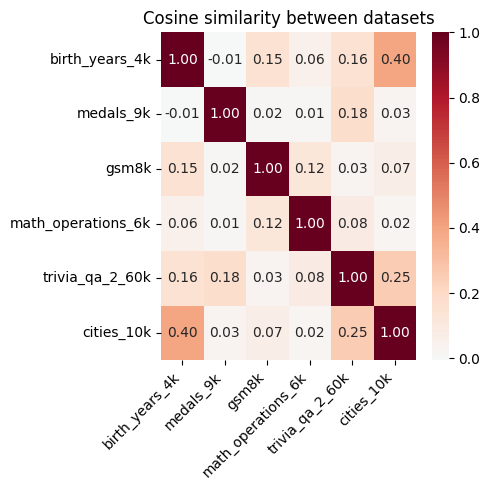

layer=(26,)


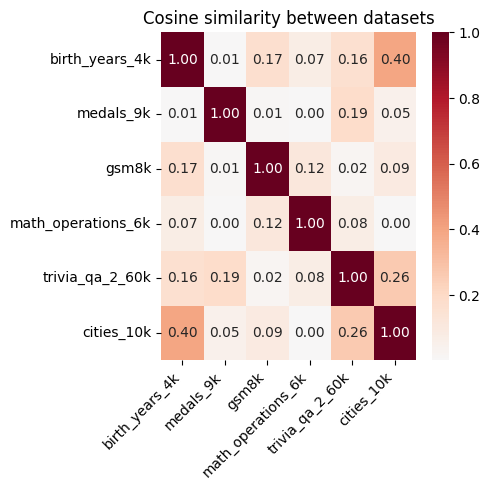

layer=(28,)


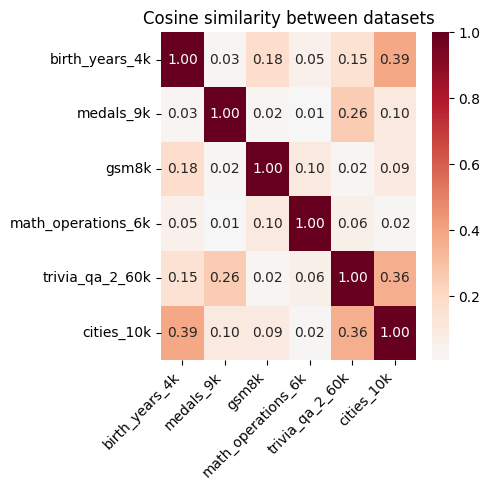

layer=(30,)


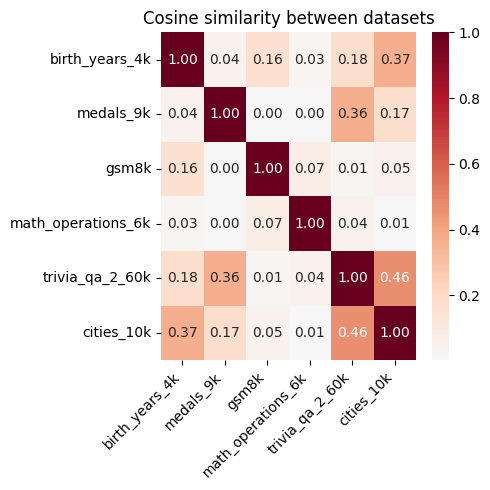

In [64]:
for layer, layer_dir_df in directions_df.groupby(["layer"]):
# for conf, layer_dir_df in directions_df.groupby(["model_id_train", "dataset_id_train", "prompt_id_train", "subset_id_train", "input_type_train", "layer"]):
    print(f"{layer=}")
    similarities = cosine_similarity_distribution(layer_dir_df["direction"], index=layer_dir_df["dataset_id_train"])
    plot_dataset_correlations(similarities, similarities.index)


In [84]:
all_layers = []
for layer, layer_dir_df in directions_df.groupby(["layer"]):
# for conf, layer_dir_df in directions_df.groupby(["model_id_train", "dataset_id_train", "prompt_id_train", "subset_id_train", "input_type_train", "layer"]):
    print(f"{layer=}")
    similarities = cosine_similarity_distribution(layer_dir_df["direction"], index=layer_dir_df["dataset_id_train"])
    # plot_dataset_correlations(similarities, indices)
    similarities = similarities.reset_index().rename(columns={0: "cosine_similarity"})
    similarities["layer"] = layer[0]
    all_layers.append(similarities)

all_similartiries_df = pd.concat(all_layers)

plot_dir_dict = {}
for pair, group_df in all_similartiries_df.groupby("index"):
    plot_dir_dict[str(pair)] = group_df.set_index("layer").drop(columns=["index"])
plot_dir_dict

plot_interactive_lineplot(
    plot_dir_dict,
    x_label="Layer",
    y_label="Cosine Similarity",
    save_path=f"./classification_data/figures/train_test_different_datasets_direction_cosine_similarity_{PCA_COMONENTS_LABEL}.html"
)


layer=(0,)
layer=(2,)
layer=(4,)
layer=(6,)
layer=(8,)
layer=(10,)
layer=(12,)
layer=(14,)
layer=(16,)
layer=(18,)
layer=(20,)
layer=(22,)
layer=(24,)
layer=(26,)
layer=(28,)
layer=(30,)


In [80]:
res_file = f"./classification_data/res_df_train_test_different_datasets{PCA_COMONENTS_LABEL}.csv"

In [81]:
res_df.drop(columns=["direction__train_set_classifying_direction"]).to_csv(res_file, index=False)

In [82]:
res_df = pd.read_csv(res_file)

In [85]:
# for metric in ["f1_score", "accuracy_score", "precision_score", "recall_score", "test_roc_auc"]:

# classifier = "direction"
for metric in [
    "direction__center_from_origin_False__classifier_cut_optimal_train_set_cut__test_roc_auc",
    "direction__center_from_origin_False__classifier_cut_optimal_train_set_cut__test_accuracy_score",
    "direction__center_from_origin_False__classifier_cut_zero__test_accuracy_score",
    "direction__center_from_origin_True__classifier_cut_optimal_train_set_cut__test_accuracy_score",
    "direction__center_from_origin_True__classifier_cut_zero__test_accuracy_score",
]:
    print(f"\n\n{metric=}")
    plot_dict = {}
    for conf, res_df_ in res_df.groupby([
        "model_id_train", 
        "dataset_id_train", 
        "prompt_id_train", 
        "subset_id_train", 
        "input_type_train",
        "model_id_test",
        "dataset_id_test",
        "prompt_id_test",
        "subset_id_test",
        "input_type_test"
    ]):
        # if conf[4] != "prompt_only":
        #     continue
        
        print(f"{conf=}")
        res_df_pivot = pd.pivot(
            res_df_.drop(columns=[
                "model_id_train",
                "dataset_id_train",
                "prompt_id_train",
                "subset_id_train",
                "input_type_train",
                "model_id_test",
                "dataset_id_test",
                "prompt_id_test",
                "subset_id_test",
                "input_type_test"
            ]),
            index='layer',
            columns='fold',
            # values=['direction_f1_score', 'logistic_regression_f1_score']  # add all metrics you want to keep
        )
        # for classifier in ["direction", "logistic_regression"]:
        #     for metric in ["f1_score", "accuracy_score", "precision_score", "recall_score"]:
        plot_dict[str(conf)] = res_df_pivot[[metric]]

    plot_interactive_lineplot(
        plot_dict,
        x_label="Layer",
        y_label=f"{metric}".replace("_", " ").title(),
        save_path=f"./classification_data/figures/train_test_different_datasets_direction_{metric}_{PCA_COMONENTS_LABEL}.html"
    ).show()





metric='direction__center_from_origin_False__classifier_cut_optimal_train_set_cut__test_roc_auc'
conf=('mistral_7b_instruct', 'birth_years_4k', 'base', 'main', 'prompt_only', 'mistral_7b_instruct', 'birth_years_4k', 'base', 'main', 'prompt_only')
conf=('mistral_7b_instruct', 'birth_years_4k', 'base', 'main', 'prompt_only', 'mistral_7b_instruct', 'cities_10k', 'base', 'main', 'prompt_only')
conf=('mistral_7b_instruct', 'birth_years_4k', 'base', 'main', 'prompt_only', 'mistral_7b_instruct', 'gsm8k', 'base_3_shot', 'main', 'prompt_only')
conf=('mistral_7b_instruct', 'birth_years_4k', 'base', 'main', 'prompt_only', 'mistral_7b_instruct', 'math_operations_6k', 'base', 'main', 'prompt_only')
conf=('mistral_7b_instruct', 'birth_years_4k', 'base', 'main', 'prompt_only', 'mistral_7b_instruct', 'medals_9k', 'base', 'main', 'prompt_only')
conf=('mistral_7b_instruct', 'birth_years_4k', 'base', 'main', 'prompt_only', 'mistral_7b_instruct', 'trivia_qa_2_60k', 'base', 'main', 'prompt_only')
conf=('



metric='direction__center_from_origin_False__classifier_cut_optimal_train_set_cut__test_accuracy_score'
conf=('mistral_7b_instruct', 'birth_years_4k', 'base', 'main', 'prompt_only', 'mistral_7b_instruct', 'birth_years_4k', 'base', 'main', 'prompt_only')
conf=('mistral_7b_instruct', 'birth_years_4k', 'base', 'main', 'prompt_only', 'mistral_7b_instruct', 'cities_10k', 'base', 'main', 'prompt_only')
conf=('mistral_7b_instruct', 'birth_years_4k', 'base', 'main', 'prompt_only', 'mistral_7b_instruct', 'gsm8k', 'base_3_shot', 'main', 'prompt_only')
conf=('mistral_7b_instruct', 'birth_years_4k', 'base', 'main', 'prompt_only', 'mistral_7b_instruct', 'math_operations_6k', 'base', 'main', 'prompt_only')
conf=('mistral_7b_instruct', 'birth_years_4k', 'base', 'main', 'prompt_only', 'mistral_7b_instruct', 'medals_9k', 'base', 'main', 'prompt_only')
conf=('mistral_7b_instruct', 'birth_years_4k', 'base', 'main', 'prompt_only', 'mistral_7b_instruct', 'trivia_qa_2_60k', 'base', 'main', 'prompt_only')




metric='direction__center_from_origin_False__classifier_cut_zero__test_accuracy_score'
conf=('mistral_7b_instruct', 'birth_years_4k', 'base', 'main', 'prompt_only', 'mistral_7b_instruct', 'birth_years_4k', 'base', 'main', 'prompt_only')
conf=('mistral_7b_instruct', 'birth_years_4k', 'base', 'main', 'prompt_only', 'mistral_7b_instruct', 'cities_10k', 'base', 'main', 'prompt_only')
conf=('mistral_7b_instruct', 'birth_years_4k', 'base', 'main', 'prompt_only', 'mistral_7b_instruct', 'gsm8k', 'base_3_shot', 'main', 'prompt_only')
conf=('mistral_7b_instruct', 'birth_years_4k', 'base', 'main', 'prompt_only', 'mistral_7b_instruct', 'math_operations_6k', 'base', 'main', 'prompt_only')
conf=('mistral_7b_instruct', 'birth_years_4k', 'base', 'main', 'prompt_only', 'mistral_7b_instruct', 'medals_9k', 'base', 'main', 'prompt_only')
conf=('mistral_7b_instruct', 'birth_years_4k', 'base', 'main', 'prompt_only', 'mistral_7b_instruct', 'trivia_qa_2_60k', 'base', 'main', 'prompt_only')
conf=('mistral_7b



metric='direction__center_from_origin_True__classifier_cut_optimal_train_set_cut__test_accuracy_score'
conf=('mistral_7b_instruct', 'birth_years_4k', 'base', 'main', 'prompt_only', 'mistral_7b_instruct', 'birth_years_4k', 'base', 'main', 'prompt_only')
conf=('mistral_7b_instruct', 'birth_years_4k', 'base', 'main', 'prompt_only', 'mistral_7b_instruct', 'cities_10k', 'base', 'main', 'prompt_only')
conf=('mistral_7b_instruct', 'birth_years_4k', 'base', 'main', 'prompt_only', 'mistral_7b_instruct', 'gsm8k', 'base_3_shot', 'main', 'prompt_only')
conf=('mistral_7b_instruct', 'birth_years_4k', 'base', 'main', 'prompt_only', 'mistral_7b_instruct', 'math_operations_6k', 'base', 'main', 'prompt_only')
conf=('mistral_7b_instruct', 'birth_years_4k', 'base', 'main', 'prompt_only', 'mistral_7b_instruct', 'medals_9k', 'base', 'main', 'prompt_only')
conf=('mistral_7b_instruct', 'birth_years_4k', 'base', 'main', 'prompt_only', 'mistral_7b_instruct', 'trivia_qa_2_60k', 'base', 'main', 'prompt_only')
c



metric='direction__center_from_origin_True__classifier_cut_zero__test_accuracy_score'
conf=('mistral_7b_instruct', 'birth_years_4k', 'base', 'main', 'prompt_only', 'mistral_7b_instruct', 'birth_years_4k', 'base', 'main', 'prompt_only')
conf=('mistral_7b_instruct', 'birth_years_4k', 'base', 'main', 'prompt_only', 'mistral_7b_instruct', 'cities_10k', 'base', 'main', 'prompt_only')
conf=('mistral_7b_instruct', 'birth_years_4k', 'base', 'main', 'prompt_only', 'mistral_7b_instruct', 'gsm8k', 'base_3_shot', 'main', 'prompt_only')
conf=('mistral_7b_instruct', 'birth_years_4k', 'base', 'main', 'prompt_only', 'mistral_7b_instruct', 'math_operations_6k', 'base', 'main', 'prompt_only')
conf=('mistral_7b_instruct', 'birth_years_4k', 'base', 'main', 'prompt_only', 'mistral_7b_instruct', 'medals_9k', 'base', 'main', 'prompt_only')
conf=('mistral_7b_instruct', 'birth_years_4k', 'base', 'main', 'prompt_only', 'mistral_7b_instruct', 'trivia_qa_2_60k', 'base', 'main', 'prompt_only')
conf=('mistral_7b_

In [13]:
# from src.visualisations.utils import visualise_clusters_dimenstionality_reduction

# labels_df_cities = load_labels(
#     base_path=BASE_PATH,
#     model_id='llama3.1_8b_chat',
#     dataset_id='cities_10k',
#     prompt_id='base',
#     subset_id='main',
# )

# activations_cities, _ = load_activations(
#     base_path=BASE_PATH,
#     model_id='llama3.1_8b_chat',
#     dataset_id='cities_10k',
#     prompt_id='base',
#     subset_id='main',
#     input_type='prompt_only',
#     # input_type='prompt_answer',
#     layer=18,
# )

# labels_df_birth_years = load_labels(
#     base_path=BASE_PATH,
#     model_id='llama3.1_8b_chat',
#     dataset_id='birth_years_4k',
#     prompt_id='base',
#     subset_id='main',
# )

# activations_birth_years, _ = load_activations(
#     base_path=BASE_PATH,
#     model_id='llama3.1_8b_chat',
#     dataset_id='birth_years_4k',
#     prompt_id='base',
#     subset_id='main',
#     input_type='prompt_only',
#     # input_type='prompt_answer',
#     layer=18,
# )

# labels_df_trivia_qa = load_labels(
#     base_path=BASE_PATH,
#     model_id='llama3.1_8b_chat',
#     dataset_id='trivia_qa_2_60k',
#     prompt_id='base',
#     subset_id='main',
# )

# activations_trivia_qa, _ = load_activations(
#     base_path=BASE_PATH,
#     model_id='llama3.1_8b_chat',
#     dataset_id='trivia_qa_2_60k',
#     prompt_id='base',
#     subset_id='main',
#     input_type='prompt_only',
#     # input_type='prompt_answer',
#     layer=18,
# )

# ah_cities = ActivationsHandler(
#     activations=activations_cities,
#     labels=labels_df_cities["correct"].astype(bool).astype(str) + "_cities",
# )

# ah_birth_years = ActivationsHandler(
#     activations=activations_birth_years,
#     labels=labels_df_birth_years["correct"].astype(bool).astype(str) + "_birth_years",
# )

# ah_trivia_qa = ActivationsHandler(
#     activations=activations_trivia_qa,
#     labels=labels_df_trivia_qa["correct"].astype(bool).astype(str) + "_trivia_qa",
# )

# ah, _ = combine_activations_handlers([ah_cities, ah_birth_years, ah_trivia_qa]).reduce_dims(pca_components=2)

# import seaborn as sns
# ax = sns.scatterplot(
#     x=ah.activations[:, 0],
#     y=ah.activations[:, 1],
#     hue=ah.labels,
# )
# ax.set_title("PCA of activations. Prompt Only")
# # ax.set_title("PCA of activations. Prompt and answer")
# ax.set_xlabel("PCA 1")
# ax.set_ylabel("PCA 2")
# ax.legend(title="Label")